In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

In [2]:
%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('retina', 'pdf')
plt.rcParams['figure.dpi'] = 100

In [3]:
import sys
sys.path.append('..')

In [32]:
from sindy import SINDy
from sindy.differentiation import TVR, FastTVR
from sindy.optimizers import STLSQ, Lasso
from sindy.features import PolynomialFeatures
from sindy.utils import odes, GaussianNoise, gen_data, Equation
from sindy.utils.plot import plot_data, plot_iou_over_noise_arg, plot_results, plot_sindy_scores, plot_sindy_scores_all


# Система линейных уравнений

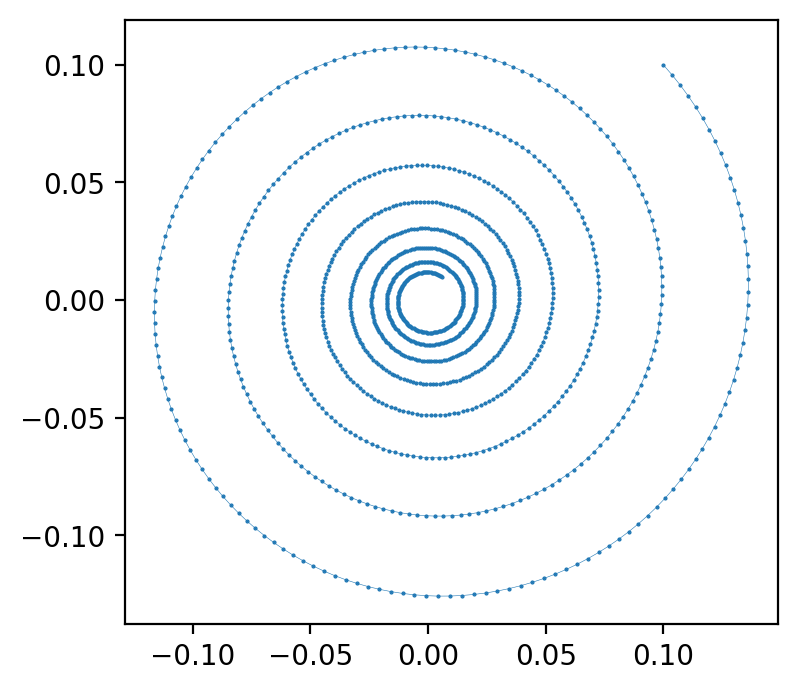

In [18]:
data, t = gen_data(odes.linear, (0, 25), 50, odes.linear.u0)
plot_data(data, t, ax_kwargs=dict(aspect='equal'))

[(1e-06, 0.00017306896551724137), (1e-06, 0.00017306896551724137), (1.820689655172414e-05, 0.00017306896551724137), (1.820689655172414e-05, 0.00015586206896551724)]


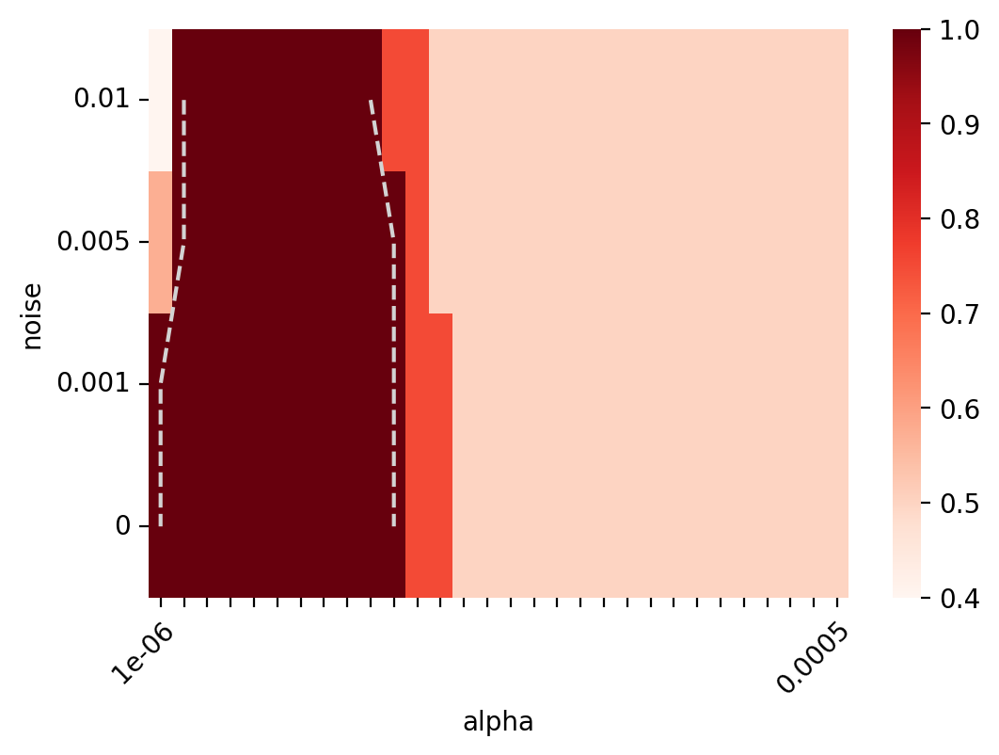

In [31]:
plot_iou_over_noise_arg(data, t, odes.linear.terms, 
                        SINDy(Lasso(), FastTVR(), PolynomialFeatures(2, include_bias=False)),
                        'alpha', np.linspace(1e-6, 5e-4, 30),
                        [0, 0.001, 0.005, 0.01],
                        [dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=5e-8)], verbose=True)

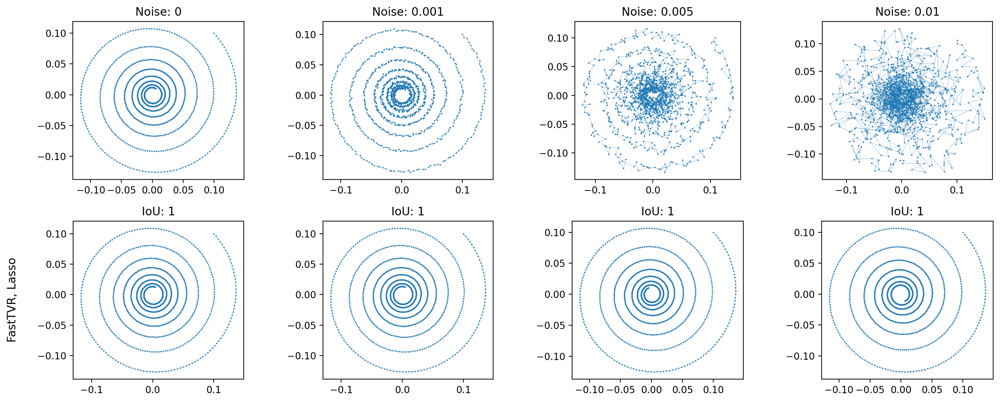

In [14]:
plot_results(data, t, odes.linear.u0, odes.linear.terms,
             {'FastTVR, Lasso': SINDy(Lasso(1e-5), FastTVR(), PolynomialFeatures(2, include_bias=False))},
             [0, 0.001, 0.005, 0.01],
             [[dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=5e-8)]], 
             size=(3, 3), ax_kwargs={'aspect': 'equal'})

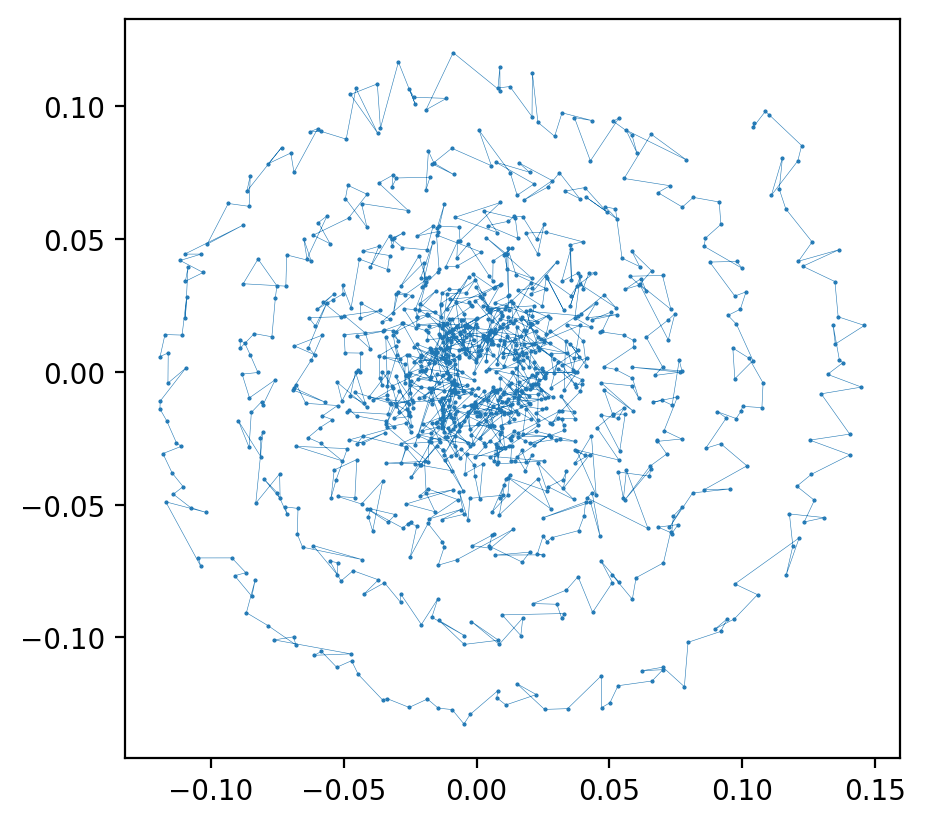

dx1 = -0.119496 * x1 + 1.96813 * x2
dx2 = -1.94056 * x1 + -0.0622096 * x2



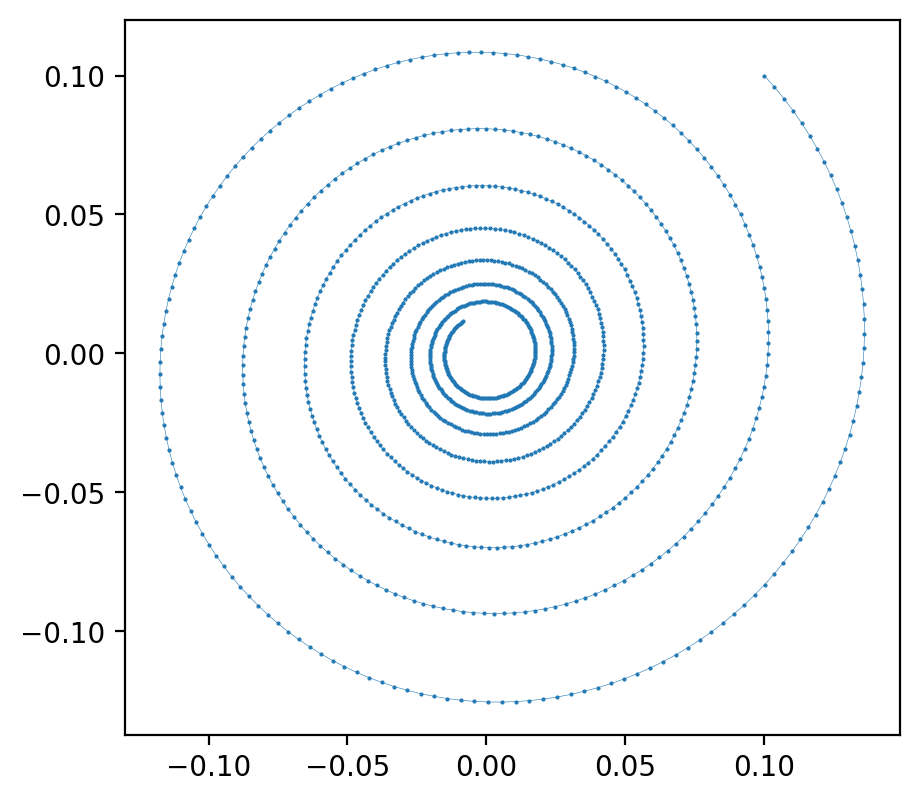

In [21]:
noise_data = GaussianNoise(scale=0.005).transform(data)
plot_data(noise_data, t, figsize=(5, 5), ax_kwargs={'aspect': 'equal'})

s = SINDy(Lasso(alpha=1e-5), FastTVR(alpha=1e-8), PolynomialFeatures(2, include_bias=False))
s.fit(noise_data, t)
print(s.print_equation(fmt='g'))

eq = s.get_equation()
id_data, _ = gen_data(eq, t, 50, odes.linear.u0)
plot_data(id_data, t, figsize=(5, 5), ax_kwargs={'aspect': 'equal'})

# Система Лоренца

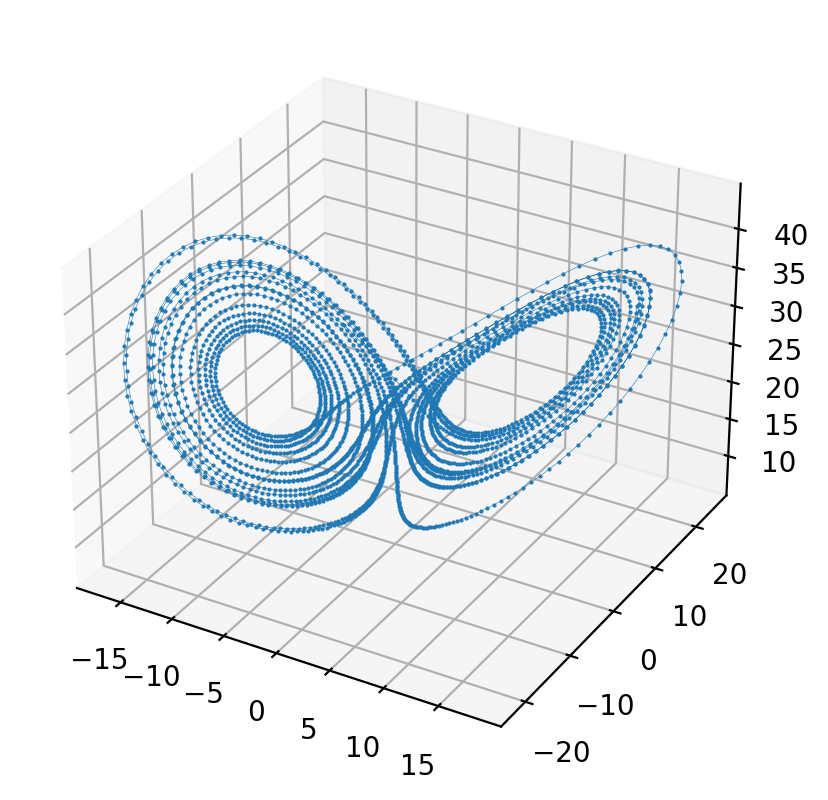

In [5]:
data, t = gen_data(odes.lorenz_attractor, (0, 20), 150, odes.lorenz_attractor.u0)
plot_data(data, t, figsize=(5, 5))

[(17.778333333333336, 22.626696969696972), (17.778333333333336, 22.626696969696972), (17.778333333333336, 22.626696969696972), (17.374303030303032, 22.22266666666667), (17.778333333333336, 22.22266666666667), (17.374303030303032, 22.626696969696972), (17.374303030303032, 18.990424242424247)]


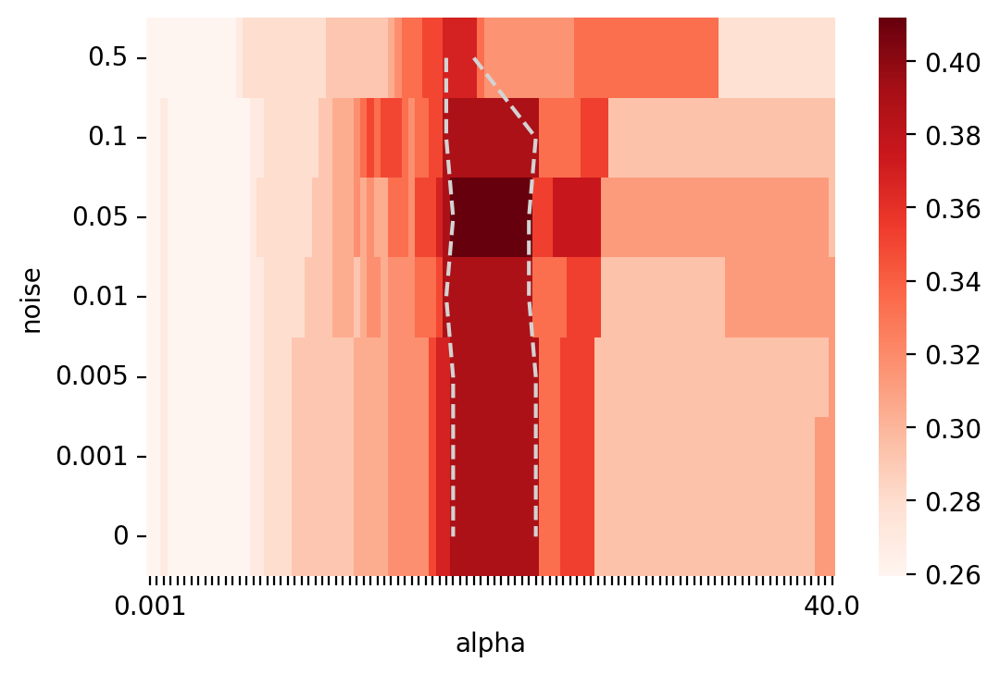

In [ ]:
plot_iou_over_noise_arg(data, t, odes.lorenz_attractor.terms, 
                        SINDy(Lasso(max_iter=10), FastTVR(), PolynomialFeatures(2, include_bias=False)),
                        'alpha', np.linspace(0.001, 40, 100),
                        [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5],
                        [dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=5e-8), dict(dif__alpha=5e-8), dict(dif__alpha=1e-7), dict(dif__alpha=5e-7)], verbose=True)

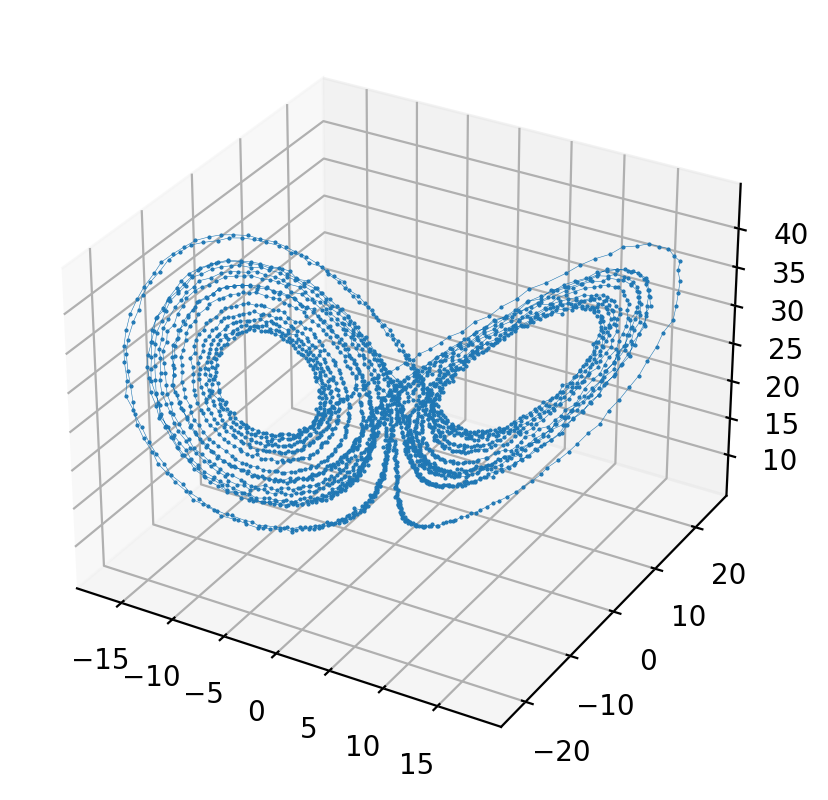

c:\Users\iktovr\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.883e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(


dx1 = 1.2 * x2 + -0.3 * x1 x3 + 0.00051 * x2^2 + 0.28 * x2 x3 + 0.0013 * x3^2
dx2 = 0.47 * x1 + 12 * x2 + 0.0026 * x1^2 + -0.26 * x1 x3 + -0.32 * x2 x3 + -0.004 * x3^2
dx3 = -0.72 * x3 + 0.57 * x1^2 + 0.57 * x1 x2 + 9e-05 * x1 x3 + 0.035 * x2^2 + -0.088 * x3^2



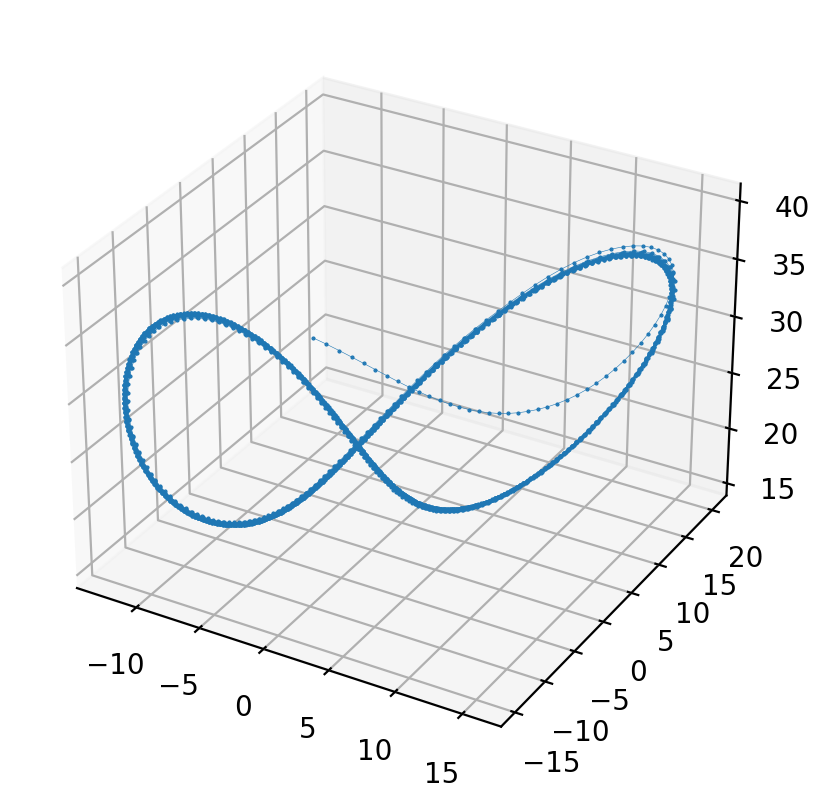

In [ ]:
noise_data = GaussianNoise(scale=0.1).transform(data)
plot_data(noise_data, t, figsize=(5, 5))

s = SINDy(Lasso(alpha=20), FastTVR(alpha=1e-7), PolynomialFeatures(2, include_bias=False))
s.fit(noise_data, t)
print(s.print_equation(fmt='.2g'))

eq = s.get_equation()
id_data, _ = gen_data(eq, t, 150, odes.lorenz_attractor.u0)
plot_data(id_data, t, figsize=(5, 5))

[(0.05182068965517242, 0.8793517241379311), (0.05182068965517242, 0.8793517241379311), (0.05182068965517242, 0.8793517241379311), (0.05182068965517242, 0.7759103448275863), (0.10354137931034484, 0.7759103448275863), (0.05182068965517242, 0.4655862068965517), (0.15526206896551725, 0.3104241379310345), (0.25870344827586206, 0.5173068965517241)]


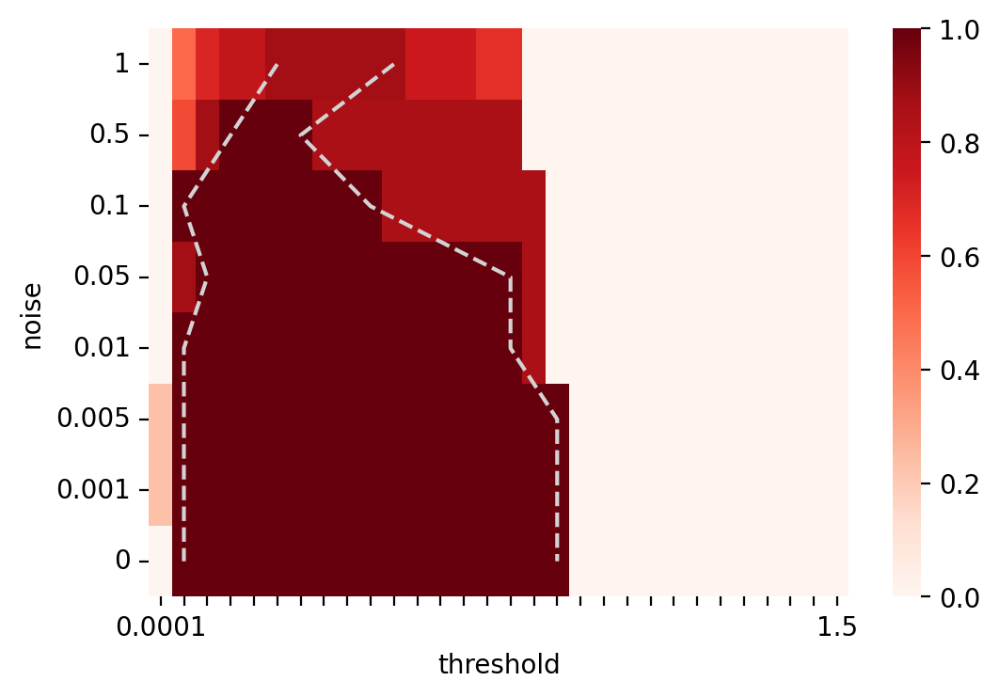

In [ ]:
plot_iou_over_noise_arg(data, t, odes.lorenz_attractor.terms, 
                        SINDy(STLSQ(), FastTVR(alpha=1e-8), PolynomialFeatures(2)),
                        'threshold', np.linspace(0.0001, 1.5, 30),
                        [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1],
                        [dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=5e-8), dict(dif__alpha=5e-8), dict(dif__alpha=1e-7), dict(dif__alpha=2.5e-7), dict(dif__alpha=7.5e-7)], verbose=True)

[(0.05182068965517242, 0.8793517241379311), (0.05182068965517242, 0.8793517241379311), (0.05182068965517242, 0.8793517241379311), (0.10354137931034484, 0.8793517241379311), (0.10354137931034484, 0.8793517241379311), (0.15526206896551725, 0.4138655172413793), (0.20698275862068966, 0.3621448275862069), (0.15526206896551725, 0.3104241379310345)]


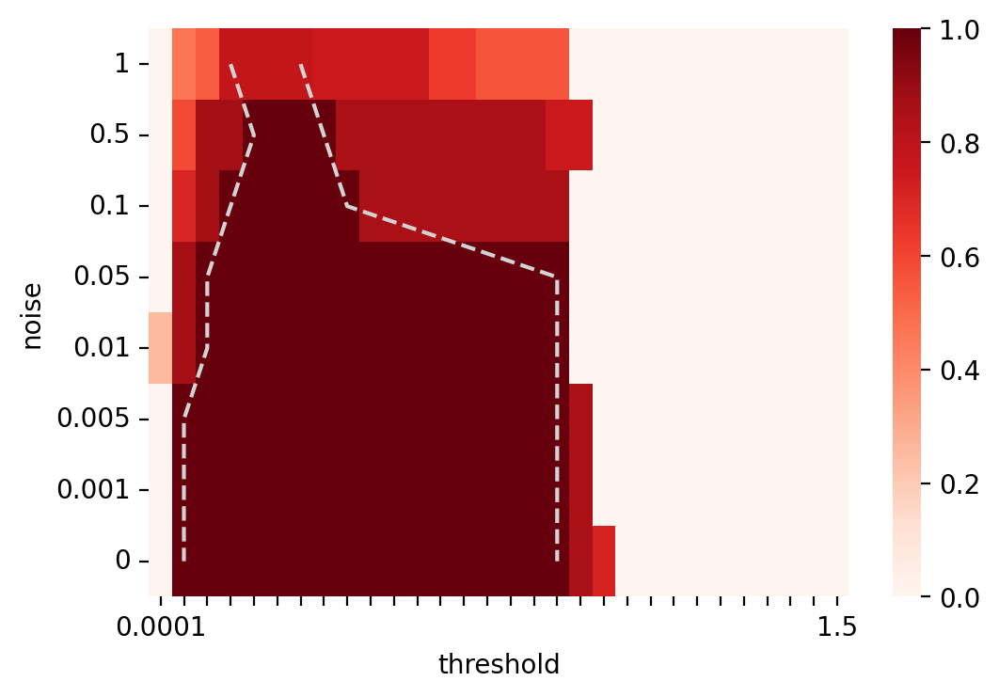

In [ ]:
plot_iou_over_noise_arg(data, t, odes.lorenz_attractor.terms, 
                        SINDy(STLSQ(), TVR(), PolynomialFeatures(2)),
                        'threshold', np.linspace(0.0001, 1.5, 30),
                        [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1],
                        [dict(dif__alpha=1e-8), dict(dif__alpha=5e-6), dict(dif__alpha=1e-5), dict(dif__alpha=5e-5), dict(dif__alpha=1e-4), dict(dif__alpha=5e-4), dict(dif__alpha=7.5e-4), dict(dif__alpha=1e-3)], verbose=True)

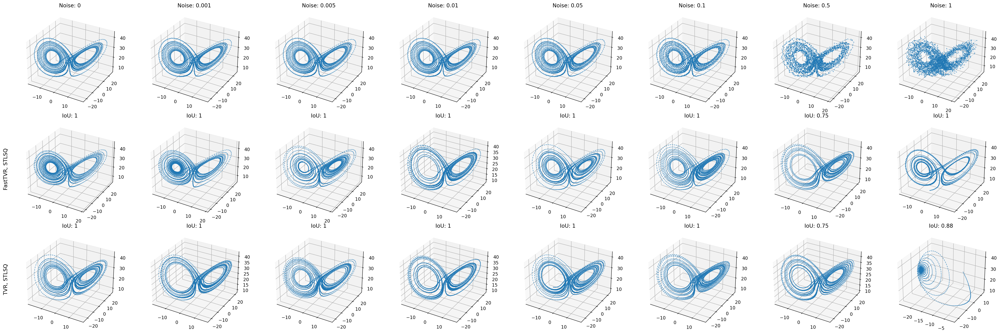

In [ ]:
coefs = plot_results(data, t, odes.lorenz_attractor.u0, odes.lorenz_attractor.terms,
             {'FastTVR, STLSQ': SINDy(STLSQ(0.3), FastTVR(), PolynomialFeatures(2)),
              'TVR, STLSQ': SINDy(STLSQ(0.3), TVR(), PolynomialFeatures(2))},
             [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1],
             [[dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=5e-8), dict(dif__alpha=5e-8), dict(dif__alpha=1e-7), dict(optim__threshold=0.5, dif__alpha=2.5e-7), dict(optim__threshold=0.5, dif__alpha=7.5e-7)],
              [dict(dif__alpha=1e-8), dict(dif__alpha=5e-6), dict(dif__alpha=1e-5), dict(dif__alpha=5e-5), dict(dif__alpha=1e-4), dict(dif__alpha=5e-4), dict(dif__alpha=7.5e-4), dict(optim__threshold=0.3, dif__alpha=1e-3)]], 
             size=(3.5, 3.5), verbose=True, return_coefs=True)

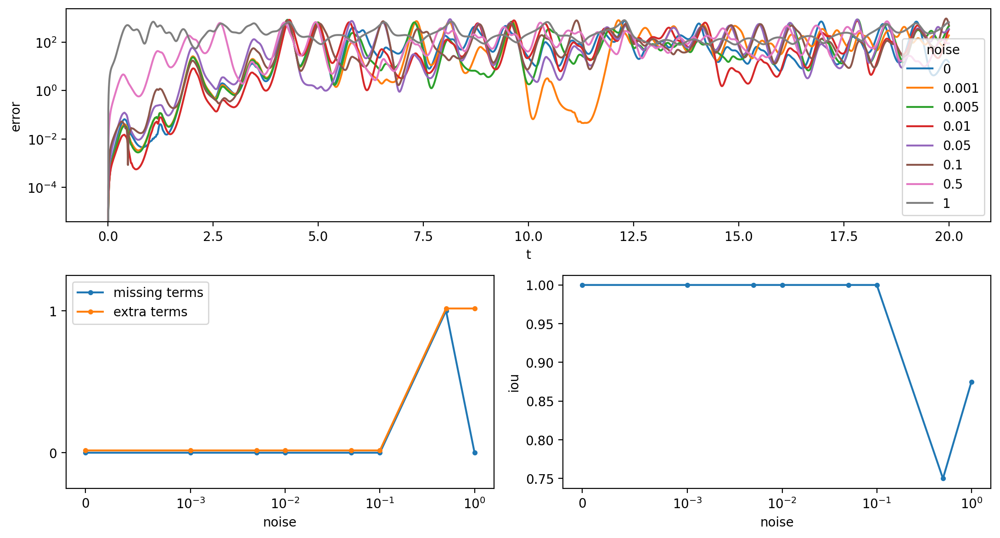

In [ ]:
plot_sindy_scores_all(data, t, odes.lorenz_attractor.u0, odes.lorenz_attractor.terms,
                      coefs[1], PolynomialFeatures(2),
                      [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1])

In [ ]:
s = SINDy(STLSQ(0.3), FastTVR(1e-8), PolynomialFeatures(2)).fit(data, t)
for coef in coefs[1]:
    s.coef_ = coef
    print(s.print_equation(fmt='g'))

dx1 = -10.0058 * x1 + 10.0061 * x2
dx2 = 27.7942 * x1 + -0.91703 * x2 + -0.99335 * x1 x3
dx3 = -2.67045 * x3 + 0.999893 * x1 x2

dx1 = -9.97686 * x1 + 9.98206 * x2
dx2 = 27.7839 * x1 + -0.917756 * x2 + -0.993196 * x1 x3
dx3 = -2.66779 * x3 + 0.999419 * x1 x2

dx1 = -9.97389 * x1 + 9.97992 * x2
dx2 = 27.7791 * x1 + -0.919832 * x2 + -0.993095 * x1 x3
dx3 = -2.66742 * x3 + 0.999414 * x1 x2

dx1 = -9.9702 * x1 + 9.97778 * x2
dx2 = 27.7601 * x1 + -0.933429 * x2 + -0.992771 * x1 x3
dx3 = -2.66658 * x3 + 0.999032 * x1 x2

dx1 = -9.97049 * x1 + 9.97792 * x2
dx2 = 27.6299 * x1 + -0.860735 * x2 + -0.989026 * x1 x3
dx3 = -2.66799 * x3 + 0.998648 * x1 x2

dx1 = -9.9093 * x1 + 9.92979 * x2
dx2 = 27.3587 * x1 + -0.833222 * x2 + -0.981524 * x1 x3
dx3 = -2.64744 * x3 + 0.989565 * x1 x2

dx1 = -9.60533 * x1 + 9.68269 * x2
dx2 = 25.5537 * x1 + -0.939365 * x1 x3
dx3 = 1.20045 * 1 + -2.65816 * x3 + 0.976933 * x1 x2

dx1 = 2.74147 * 1 + -0.437593 * x1 + 4.44842 * x2
dx2 = 23.0312 * x1 + 0.326809 * x2 + -0.

# Система Мура-Шпигеля

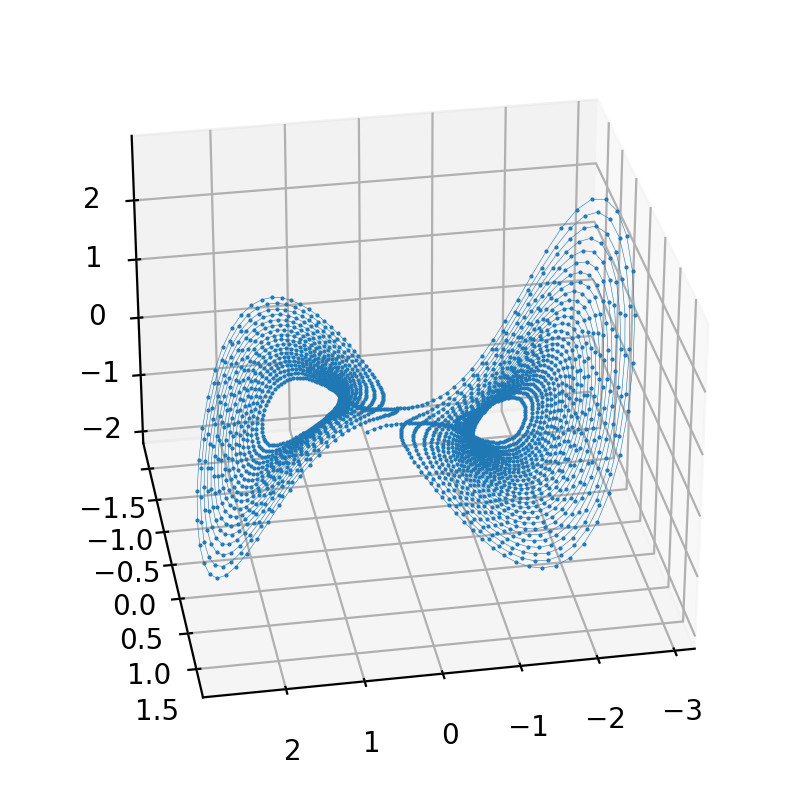

In [29]:
data, t = gen_data(odes.moore_spiegel, (600, 900), 10, odes.moore_spiegel.u0)
plot_data(data, t, figsize=(5, 5), azim=80)

In [38]:
from sindy.utils.plot import plot_dif_results

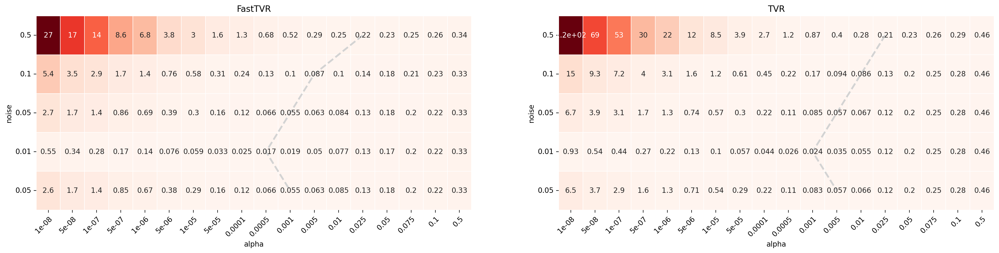

In [51]:
tvr = TVR()
fast_tvr = FastTVR()

noise = [0.05, 0.01, 0.05, 0.1, 0.5]
alpha = np.array([1e-8, 5e-8, 1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4, 0.001, 0.005, 0.01, 0.025, 0.05, 0.075, 0.1, 0.5])

fig = plt.figure(figsize=(24, 5))
ax = fig.subplots(1, 2)

ax[0].set_title('FastTVR')
error = plot_dif_test_arg_noise(data, (600, 900), 10, fast_tvr, 'alpha', alpha, noise, repeat=1, return_error=True, ax=ax[0], cbar=False, verbose=True)

ax[1].set_title('TVR')
error = plot_dif_test_arg_noise(data, (600, 900), 10, tvr, 'alpha', alpha, noise, repeat=1, return_error=True, ax=ax[1], cbar=False, verbose=True)
plt.show()

In [76]:
noise_values = [0, 0.001, 0.005, 0.01, 0.05, 0.1]
fast_tvr_params = [{'dif__alpha': 0.0001}, {'dif__alpha': 0.0001}, {'dif__alpha': 0.0005, 'optim__threshold': 0.08}, {'dif__alpha': 0.0005}, {'dif__alpha': 0.001}, {'dif__alpha': 0.005, 'optim__threshold': 0.07}]
tvr_params = [{'dif__alpha': 1.0e-07}, {'dif__alpha': 1.0e-04}, {'dif__alpha': 5.0e-04, 'optim__threshold': 0.012}, {'dif__alpha': 1.0e-03, 'optim__threshold': 0.15}, {'dif__alpha': 5.0e-03}, {'dif__alpha': 0.01}]

[(0.00929145728643216, 0.011381909547738694), (0.009412060301507538, 0.011100502512562813)]


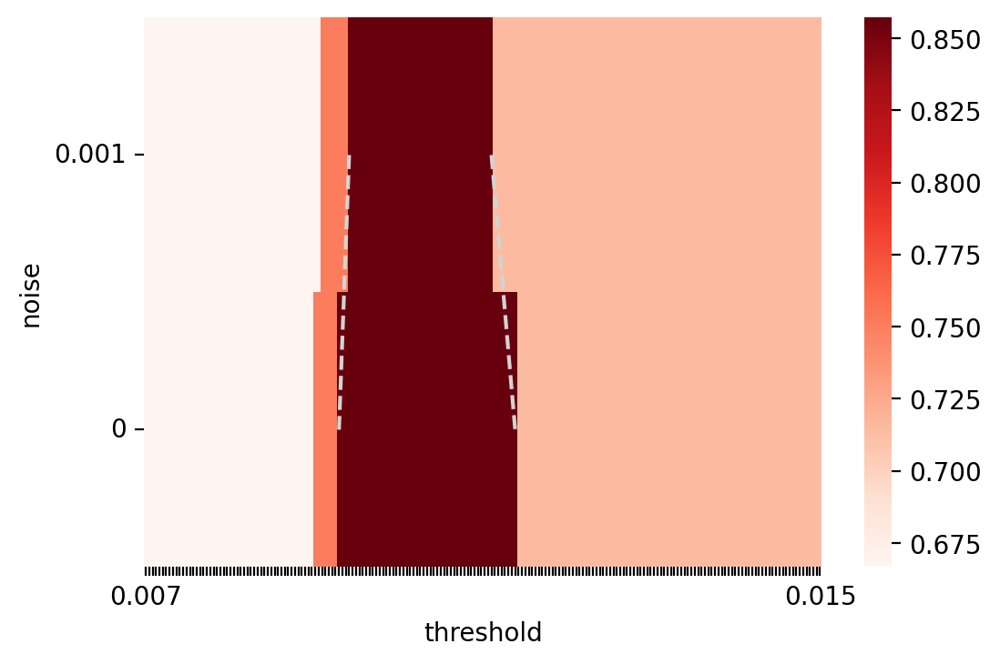

[(0.01949748743718593, 0.1), (0.023115577889447236, 0.1), (0.08417085427135679, 0.1), (0.04618090452261307, 0.08326633165829146), (0.05839195979899498, 0.1)]


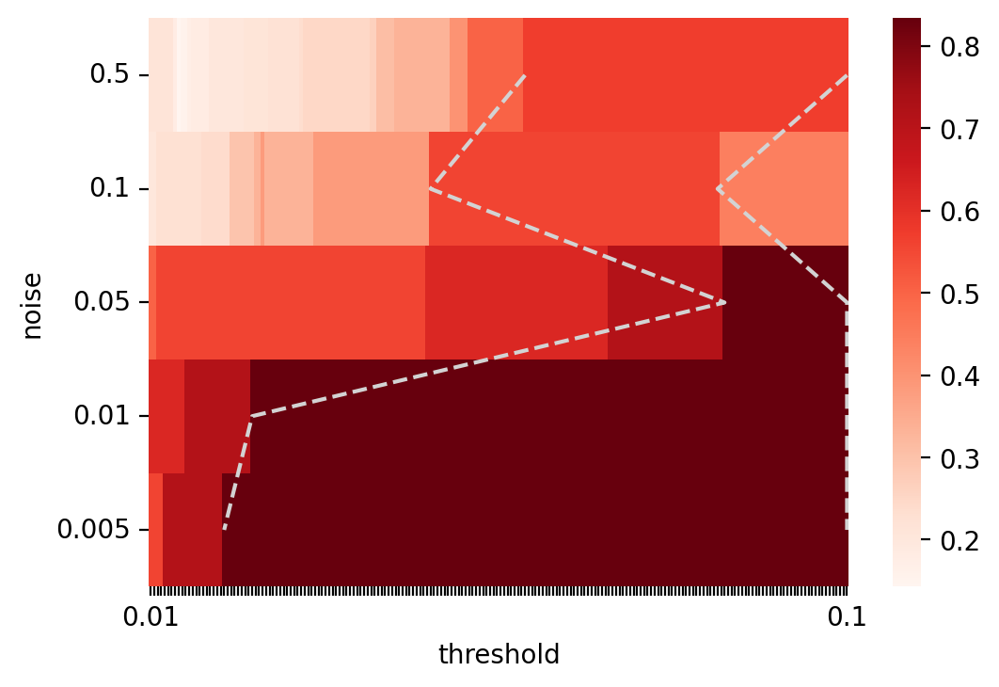

In [63]:
plot_iou_over_noise_arg(data, t, odes.moore_spiegel.terms, 
                        SINDy(STLSQ(), FastTVR(), PolynomialFeatures(3)),
                        'threshold', np.linspace(0.007, 0.015, 200),
                        noise_values[:2], fast_tvr_params)
plot_iou_over_noise_arg(data, t, odes.moore_spiegel.terms, 
                        SINDy(STLSQ(), FastTVR(), PolynomialFeatures(3)),
                        'threshold', np.linspace(0.01, 0.1, 200),
                        noise_values[2:], fast_tvr_params)

[(0.008718120805369128, 0.010865771812080538), (0.008395973154362416, 0.011080536912751678), (0.010865771812080538, 0.015)]


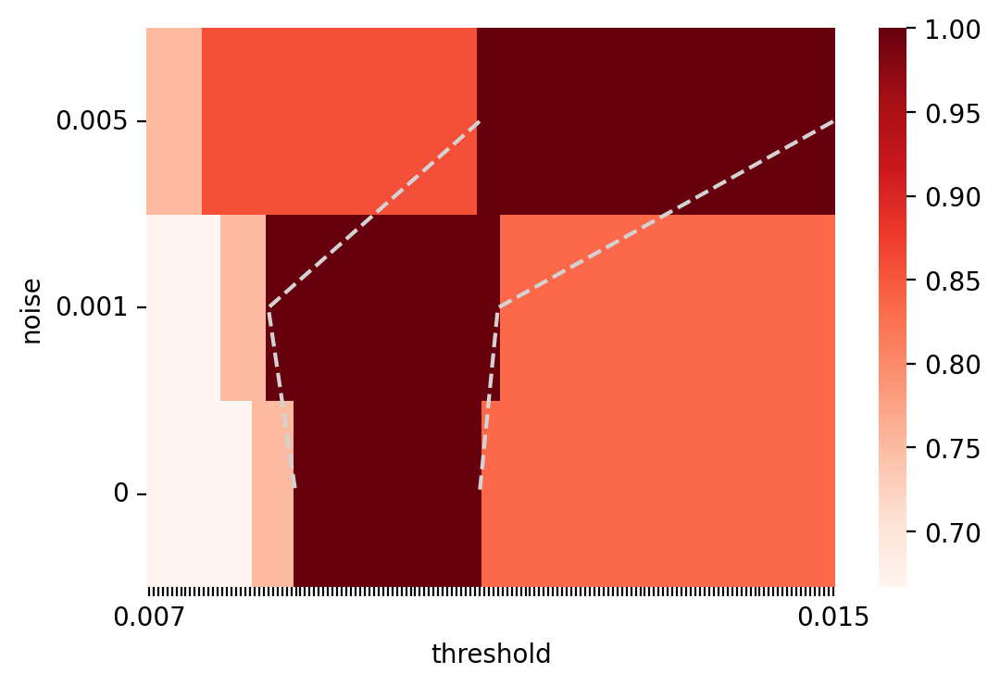

[(0.0125503355704698, 0.1846979865771812), (0.03550335570469799, 0.14644295302013424), (0.09798657718120804, 0.2), (0.07885906040268456, 0.09543624161073824)]


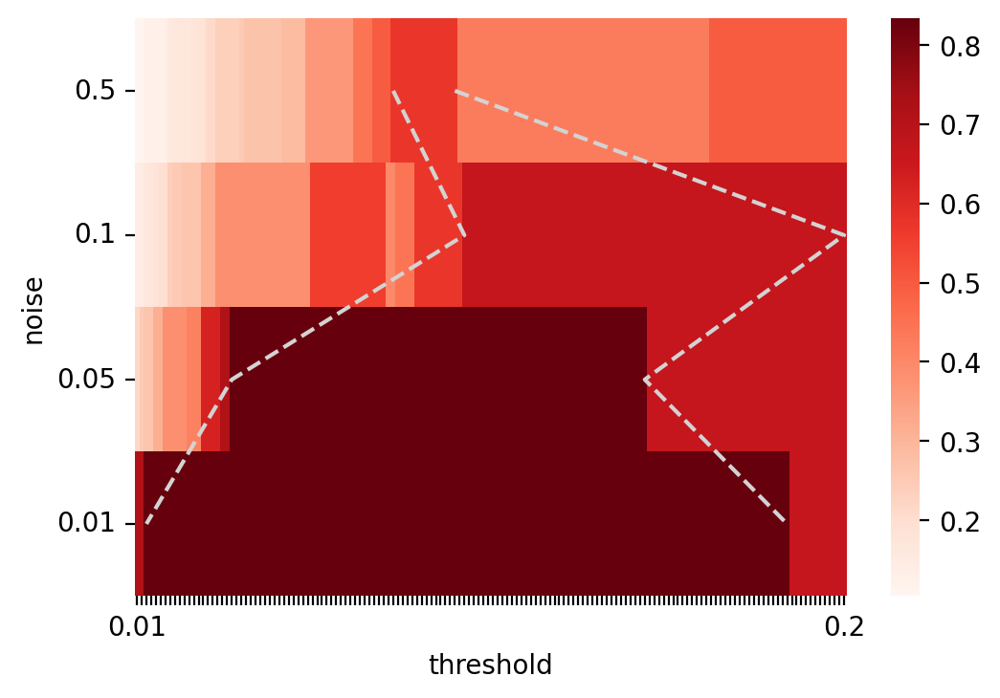

In [64]:
plot_iou_over_noise_arg(data, t, odes.moore_spiegel.terms, 
                        SINDy(STLSQ(), TVR(), PolynomialFeatures(3)),
                        'threshold', np.linspace(0.007, 0.015, 150),
                        noise_values[:3], tvr_params)
plot_iou_over_noise_arg(data, t, odes.moore_spiegel.terms, 
                        SINDy(STLSQ(), TVR(), PolynomialFeatures(3)),
                        'threshold', np.linspace(0.01, 0.2, 150),
                        noise_values[3:], fast_tvr_params)

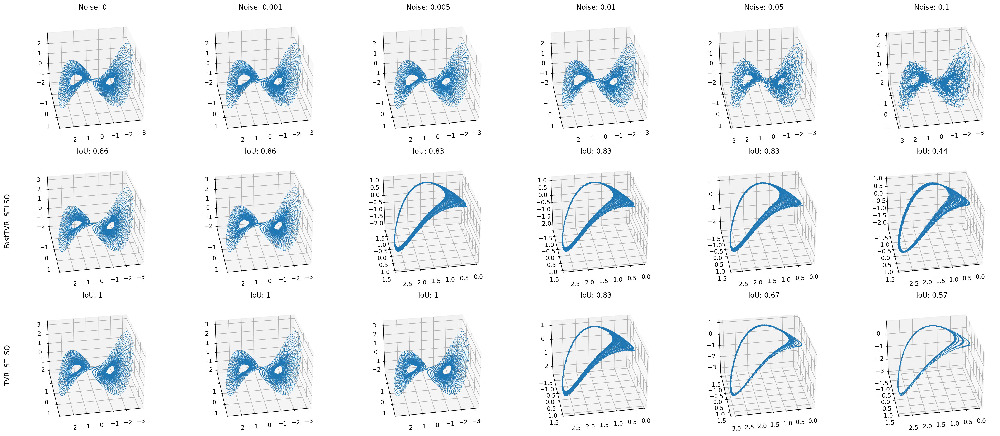

In [77]:
coefs = plot_results(data, t, odes.moore_spiegel.u0, odes.moore_spiegel.terms,
                     {'FastTVR, STLSQ': SINDy(STLSQ(0.01), FastTVR(), PolynomialFeatures(3)),
                     'TVR, STLSQ': SINDy(STLSQ(0.01), TVR(), PolynomialFeatures(3))},
                     noise_values, [fast_tvr_params, tvr_params],
                     size=(3.5, 3.5), verbose=True, return_coefs=True, azim=80)

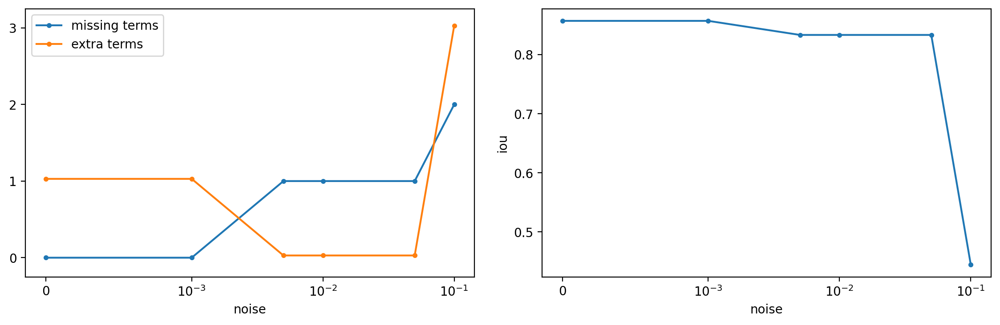

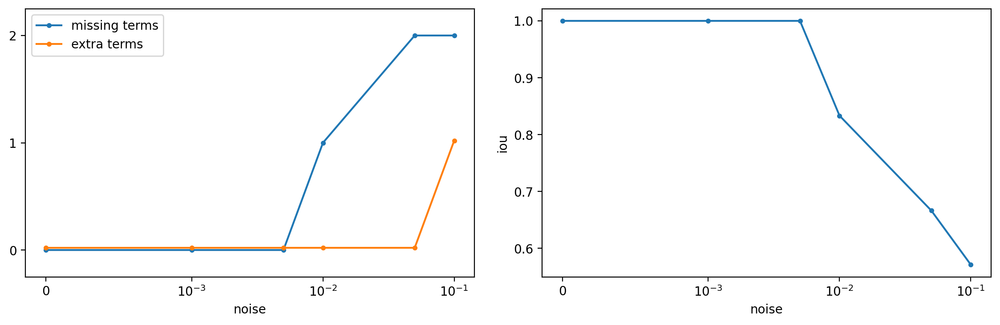

In [78]:
plot_sindy_scores(odes.moore_spiegel.terms, coefs[0], 
                  PolynomialFeatures(3),
                  [0, 0.001, 0.005, 0.01, 0.05, 0.1])
plot_sindy_scores(odes.moore_spiegel.terms, coefs[1], 
                  PolynomialFeatures(3),
                  [0, 0.001, 0.005, 0.01, 0.05, 0.1])

In [79]:
s = SINDy(STLSQ(0.01), FastTVR(1e-8), PolynomialFeatures(3)).fit(data, t)
for coef in coefs[1]:
    s.coef_ = coef
    print(s.print_equation(fmt='g'))

dx1 = 0.977747 * x2
dx2 = -0.186353 * x1 + 0.975397 * x3
dx3 = 0.99205 * x2 + -0.021043 * x3 + -0.798484 * x1^2 x2

dx1 = 0.976642 * x2
dx2 = -0.186374 * x1 + 0.975993 * x3
dx3 = 0.992841 * x2 + -0.0209123 * x3 + -0.798688 * x1^2 x2

dx1 = 0.984113 * x2
dx2 = -0.185125 * x1 + 0.977645 * x3
dx3 = 1.00627 * x2 + -0.0205423 * x3 + -0.801622 * x1^2 x2

dx1 = 0.982455 * x2
dx2 = -0.186651 * x1 + 0.97923 * x3
dx3 = 1.04622 * x2 + -0.80955 * x1^2 x2

dx1 = 0.962712 * x2
dx2 = 0.947985 * x3
dx3 = 0.90004 * x2 + -0.729239 * x1^2 x2

dx1 = 0.904667 * x2
dx2 = 0.916891 * x3
dx3 = 0.757316 * x2 + -0.64204 * x1^2 x2 + -0.166827 * x2 x3^2



# Пример из презентации

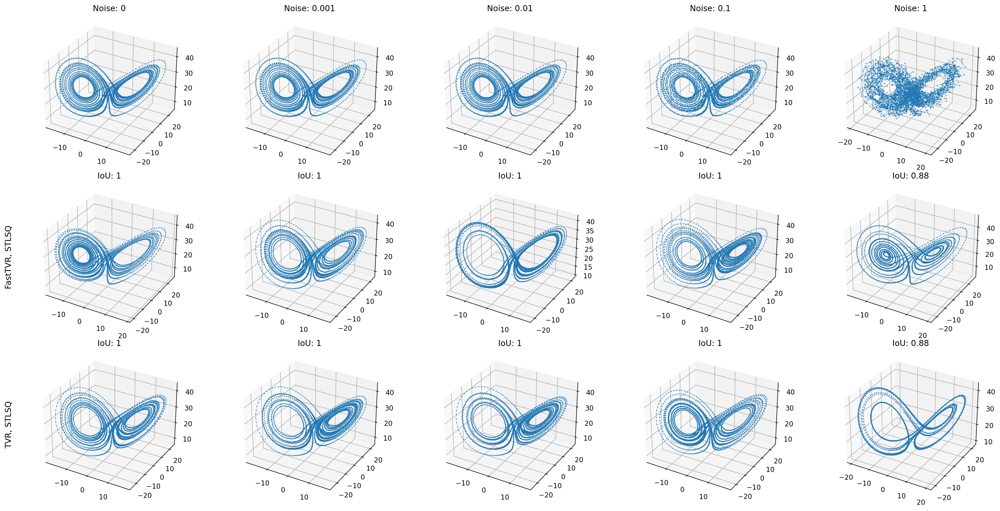

In [ ]:
coefs, noise_data = plot_results(data, t, odes.lorenz_attractor.u0, odes.lorenz_attractor.terms,
             {'FastTVR, STLSQ': SINDy(STLSQ(0.3), FastTVR(), PolynomialFeatures(2)),
              'TVR, STLSQ': SINDy(STLSQ(0.3), TVR(), PolynomialFeatures(2))},
             [0, 0.001, 0.01, 0.1, 1],
             [[dict(dif__alpha=1e-8), dict(dif__alpha=1e-8), dict(dif__alpha=5e-8), dict(dif__alpha=1e-7), dict(optim__threshold=0.5, dif__alpha=7.5e-7)],
              [dict(dif__alpha=1e-8), dict(dif__alpha=5e-6), dict(dif__alpha=5e-5), dict(dif__alpha=5e-4), dict(optim__threshold=0.2, dif__alpha=1e-3)]], 
             size=(3.5, 3.5), verbose=True, return_coefs=True, return_data=True)

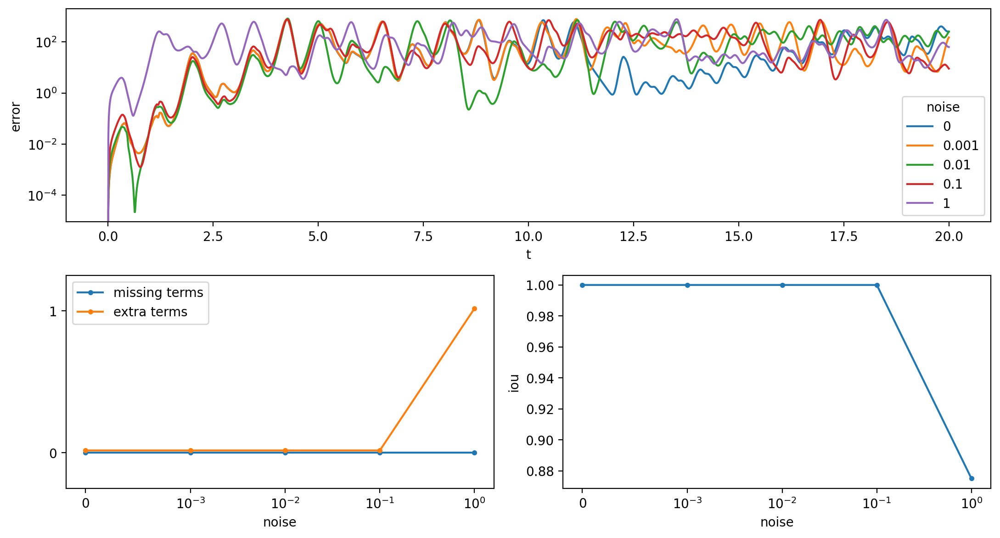

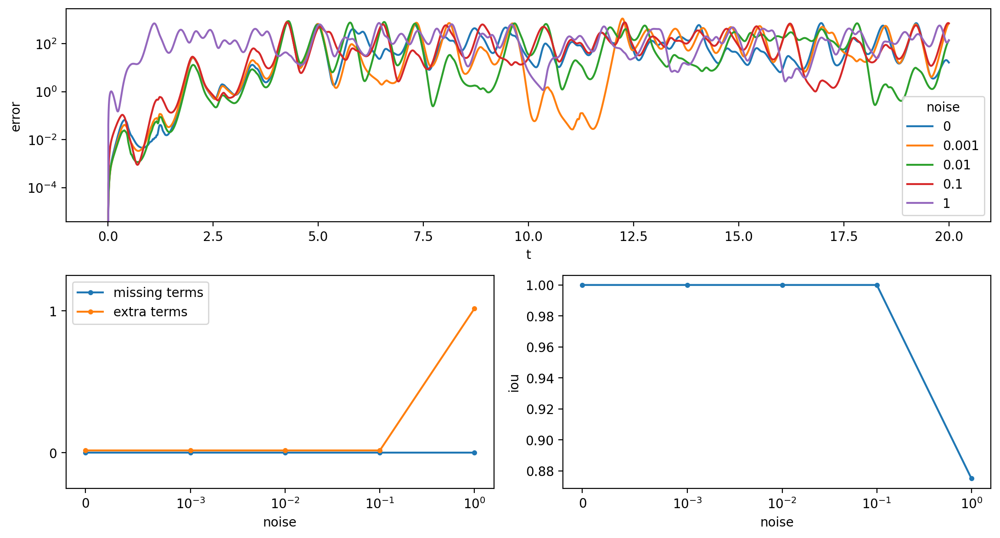

In [ ]:
plot_sindy_scores_all(data, t, odes.lorenz_attractor.u0, odes.lorenz_attractor.terms,
                      coefs[0], PolynomialFeatures(2),
                      [0, 0.001, 0.01, 0.1, 1])
plot_sindy_scores_all(data, t, odes.lorenz_attractor.u0, odes.lorenz_attractor.terms,
                      coefs[1], PolynomialFeatures(2),
                      [0, 0.001, 0.01, 0.1, 1])

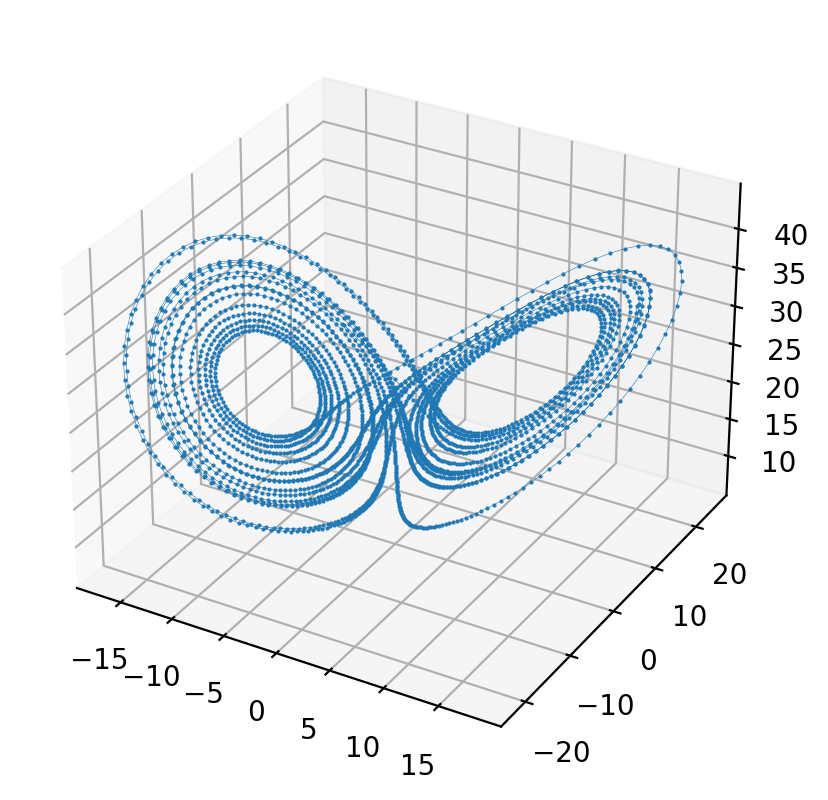

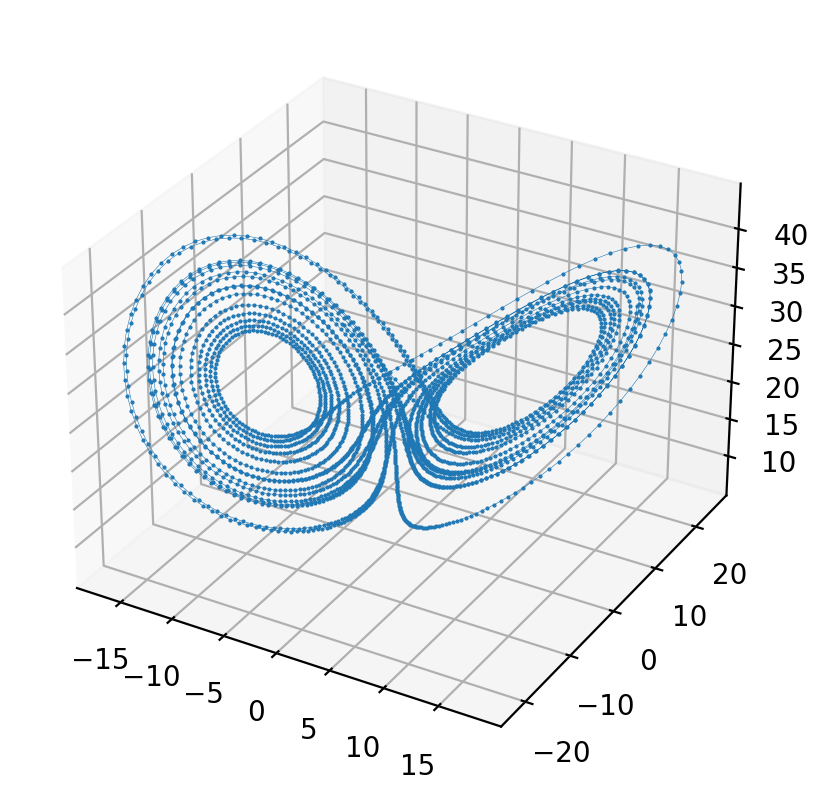

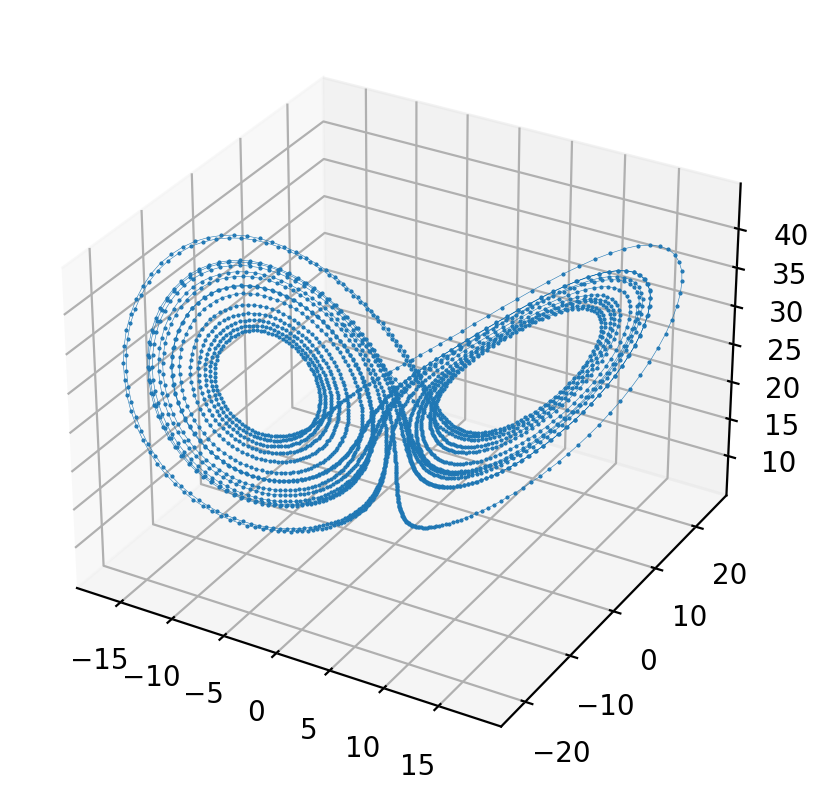

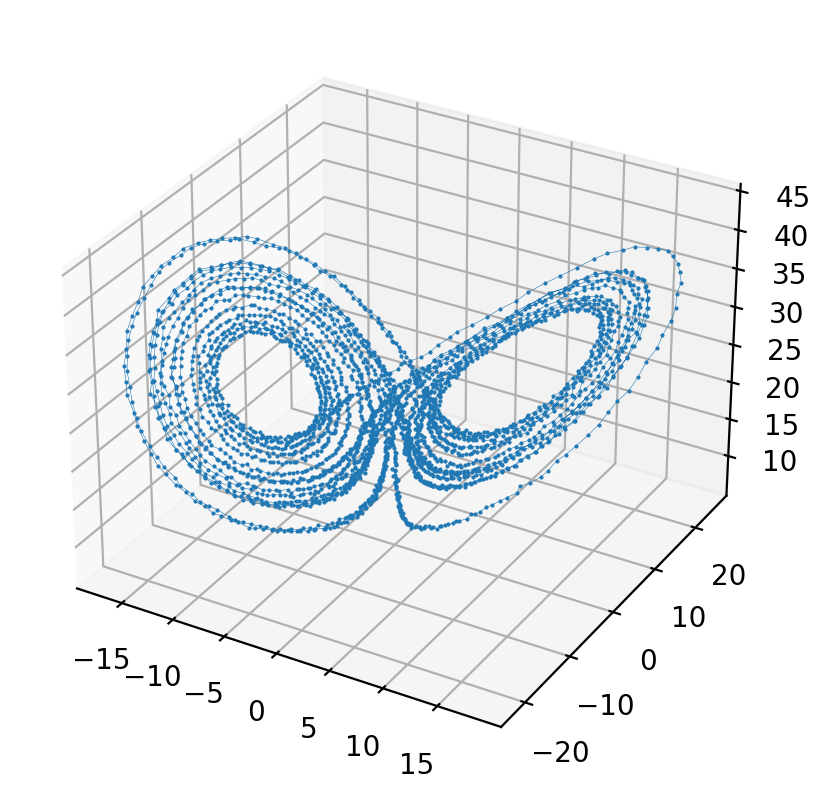

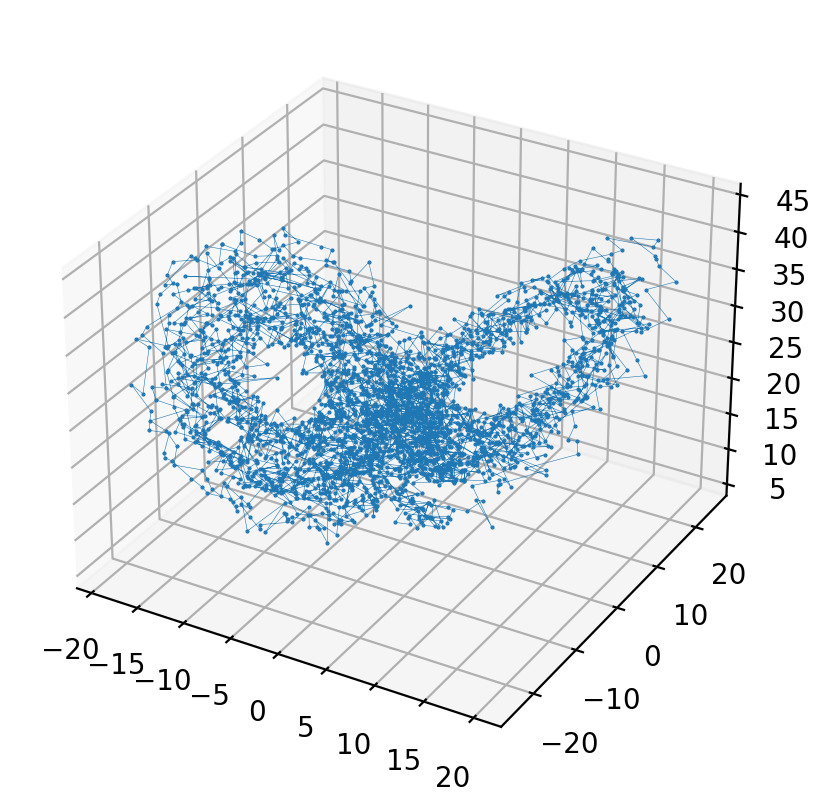

In [ ]:
for i in noise_data:
    plot_data(i, t, figsize=(5, 5))

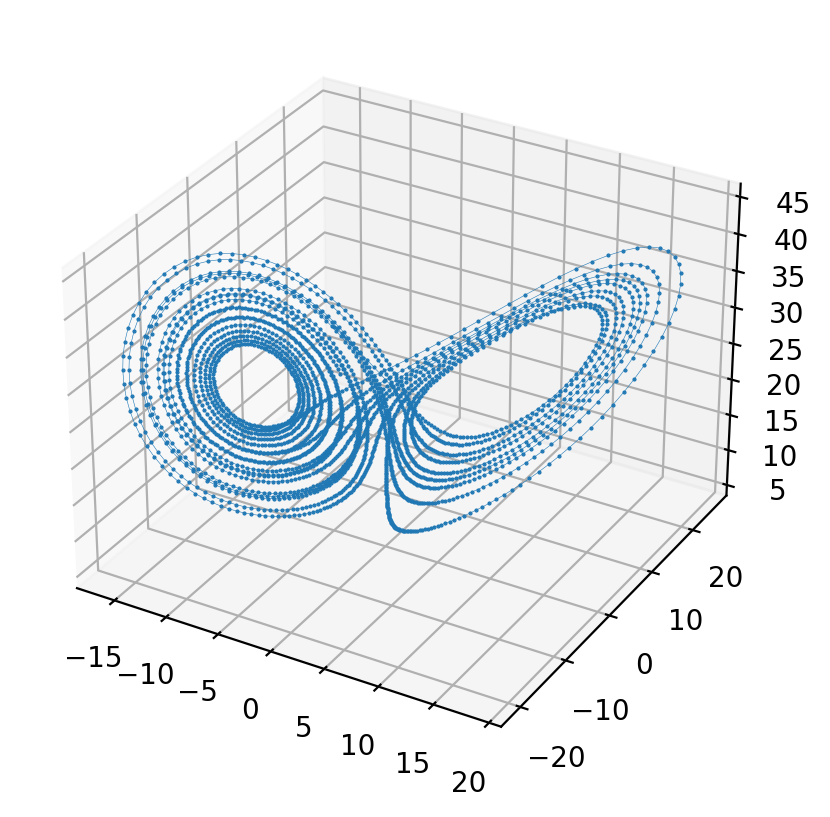

dx1 = -9.97 * x1 + 9.97557 * x2
dx2 = 27.6956 * x1 + -0.889988 * x2 + -0.990854 * x1 x3
dx3 = -2.66558 * x3 + 0.998688 * x1 x2



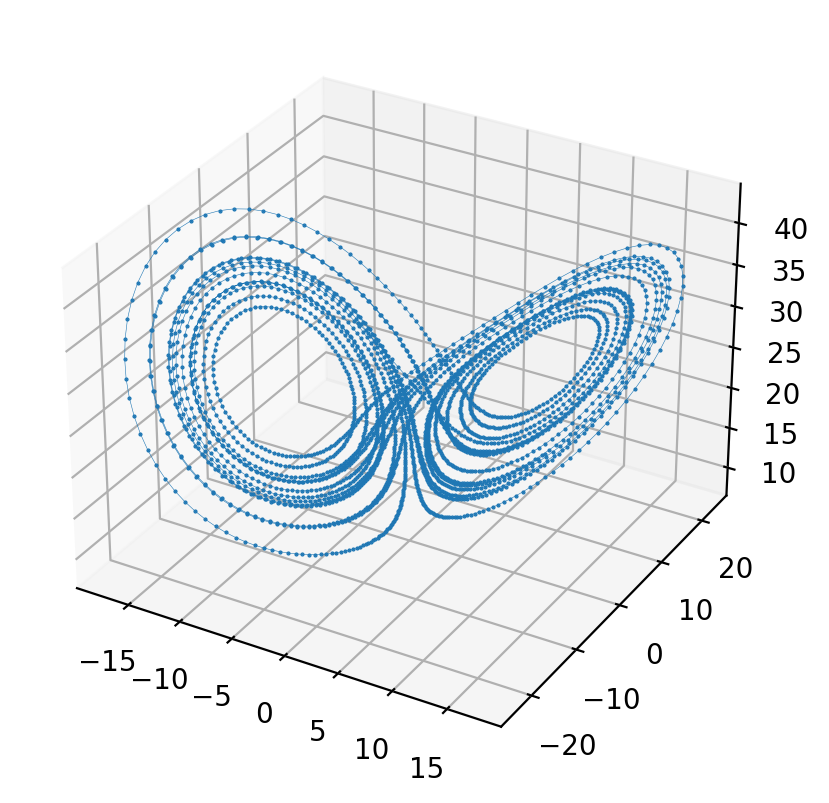

dx1 = -9.97001 * x1 + 9.97556 * x2
dx2 = 27.695 * x1 + -0.889789 * x2 + -0.990841 * x1 x3
dx3 = -2.66557 * x3 + 0.998694 * x1 x2



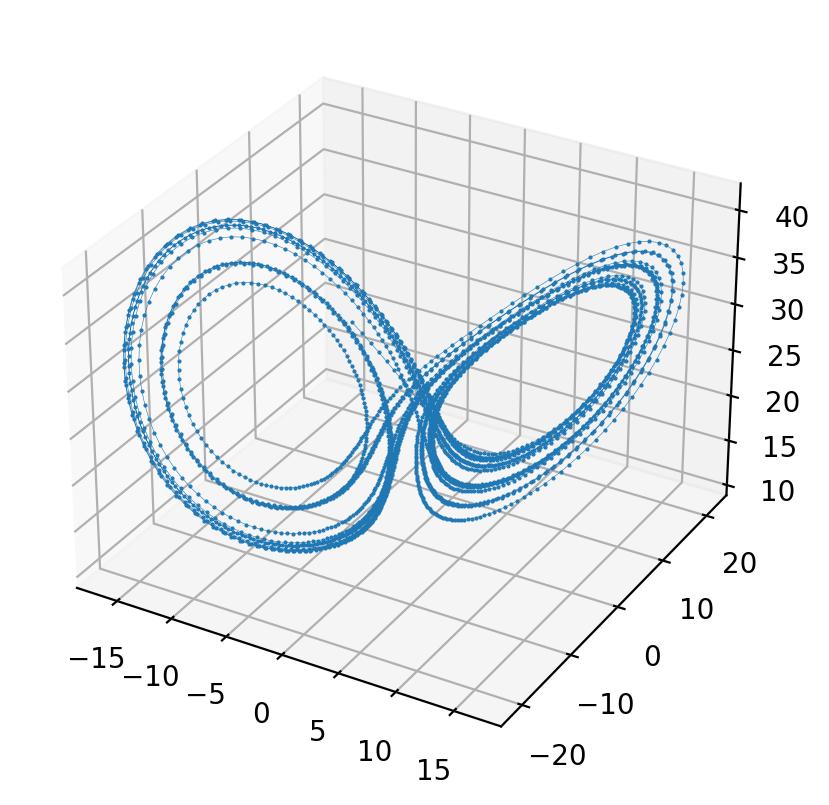

dx1 = -9.95358 * x1 + 9.96078 * x2
dx2 = 27.4811 * x1 + -0.868164 * x2 + -0.98537 * x1 x3
dx3 = -2.65827 * x3 + 0.996017 * x1 x2



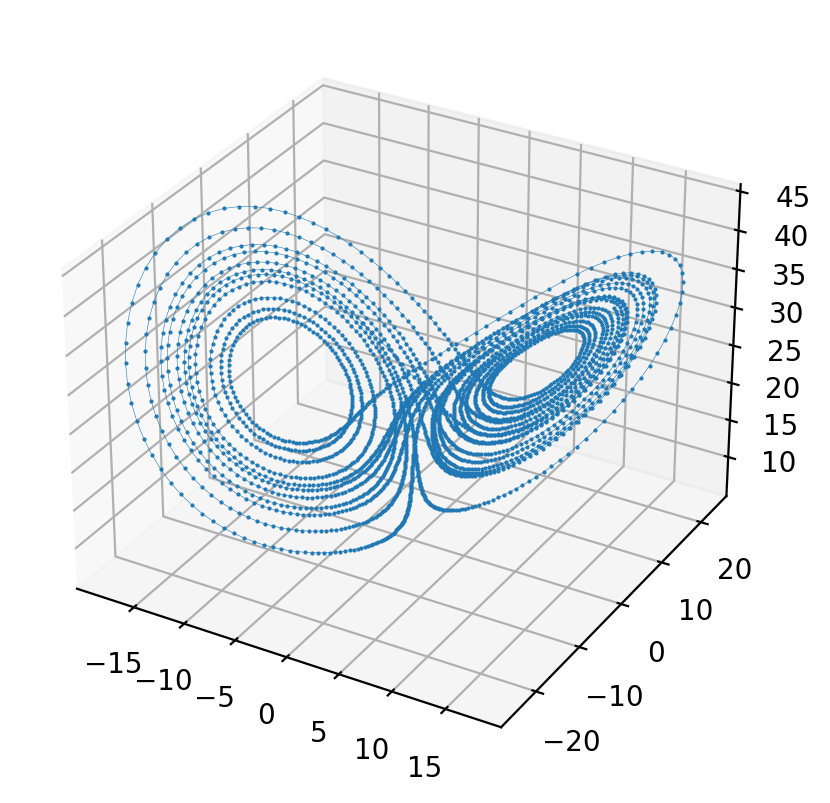

dx1 = -9.92479 * x1 + 9.93491 * x2
dx2 = 27.1 * x1 + -0.775235 * x2 + -0.975483 * x1 x3
dx3 = -2.65333 * x3 + 0.993054 * x1 x2



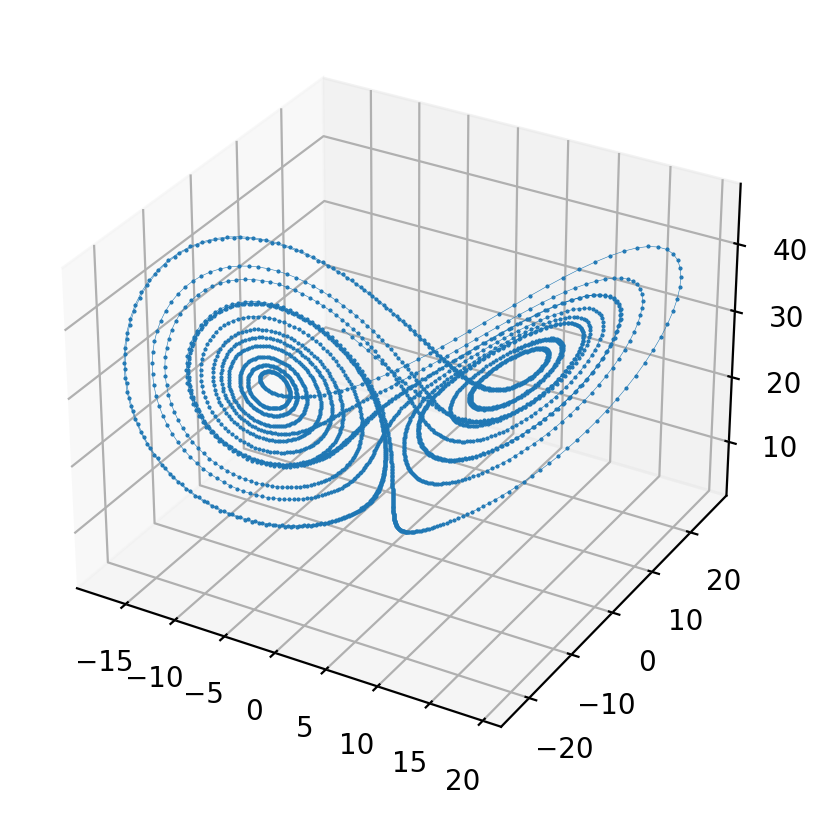

dx1 = -8.74565 * x1 + 8.85803 * x2
dx2 = 21.0993 * x1 + 0.700543 * x2 + -0.822762 * x1 x3
dx3 = -1.64622 * 1 + -2.43026 * x3 + 0.936905 * x1 x2



In [ ]:
s = SINDy(STLSQ(0.3), FastTVR(1e-8), PolynomialFeatures(2)).fit(data, t)
for coef in coefs[0]:
    s.coef_ = coef
    eq = Equation(s.feature_library, coef)
    d, _ = gen_data(eq, (0, 20), 150, odes.lorenz_attractor.u0)
    plot_data(d, t, figsize=(5, 5))
    print(s.print_equation(fmt='g'))

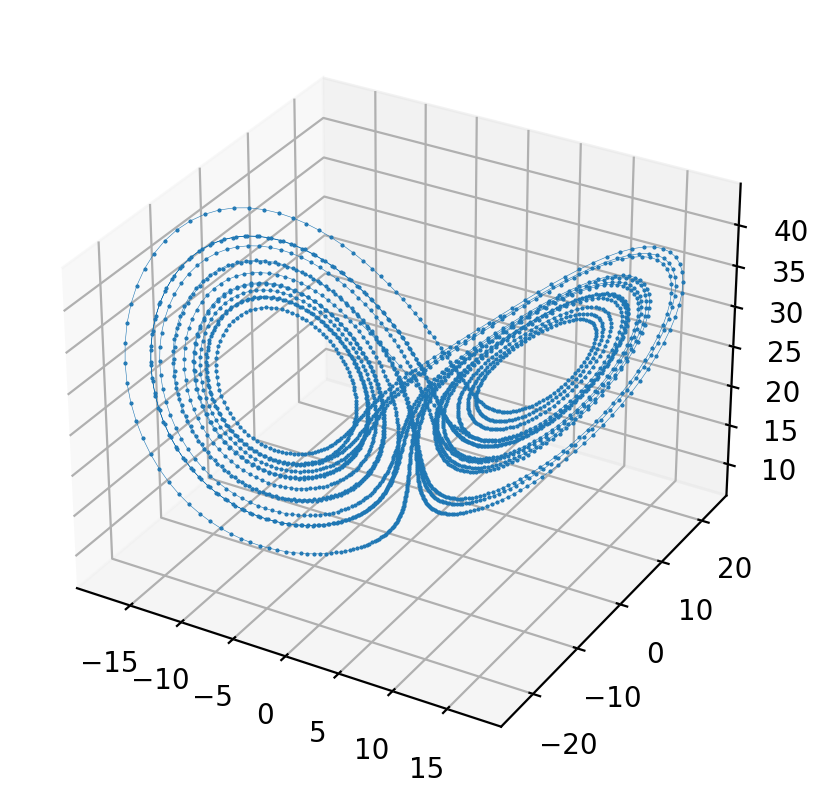

dx1 = -10.0058 * x1 + 10.0061 * x2
dx2 = 27.7942 * x1 + -0.91703 * x2 + -0.99335 * x1 x3
dx3 = -2.67045 * x3 + 0.999893 * x1 x2



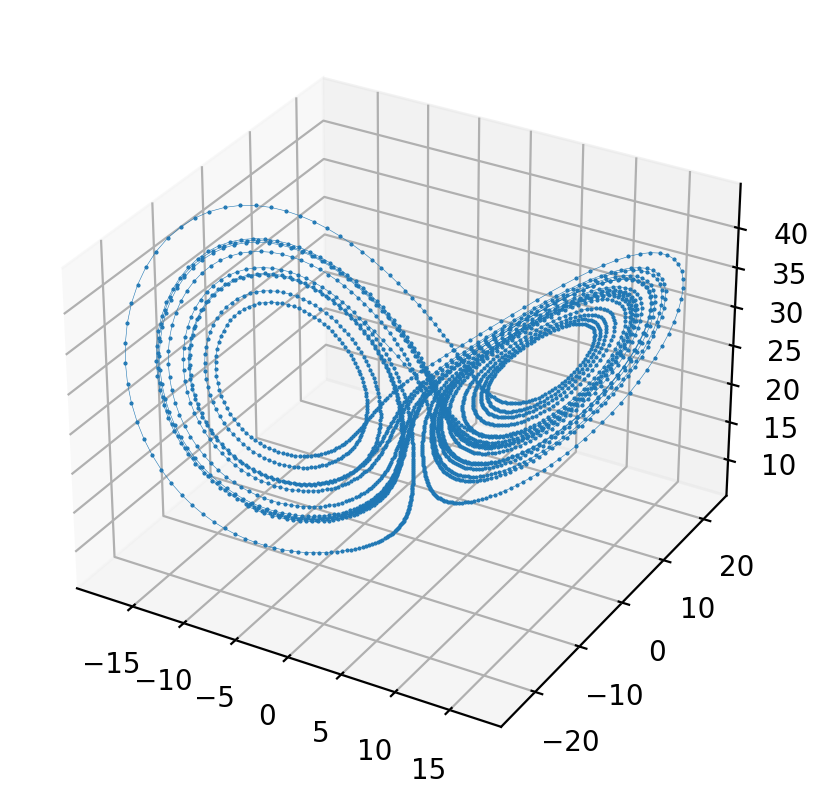

dx1 = -9.9768 * x1 + 9.98197 * x2
dx2 = 27.7842 * x1 + -0.917796 * x2 + -0.993212 * x1 x3
dx3 = -2.66773 * x3 + 0.999421 * x1 x2



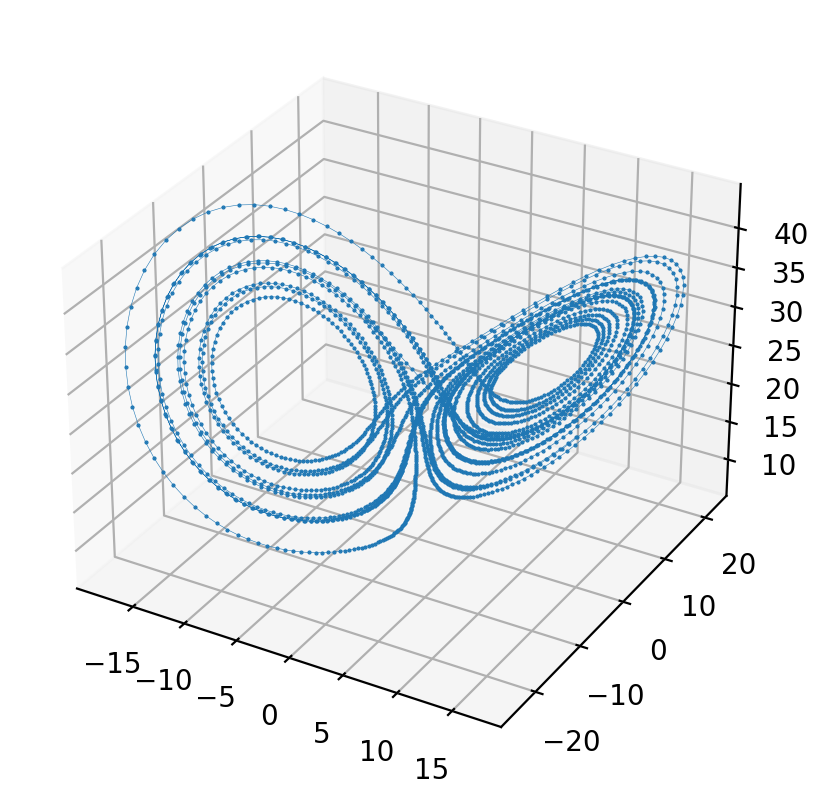

dx1 = -9.97126 * x1 + 9.97857 * x2
dx2 = 27.7423 * x1 + -0.923694 * x2 + -0.992214 * x1 x3
dx3 = -2.66665 * x3 + 0.99917 * x1 x2



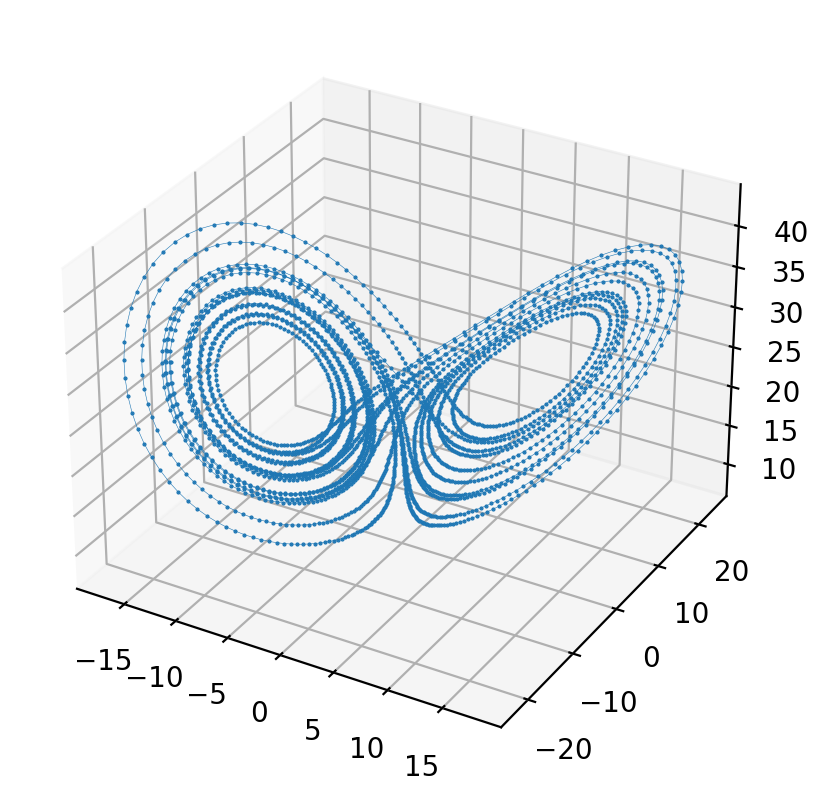

dx1 = -9.93379 * x1 + 9.94639 * x2
dx2 = 27.2416 * x1 + -0.803425 * x2 + -0.978794 * x1 x3
dx3 = -2.65222 * x3 + 0.990401 * x1 x2



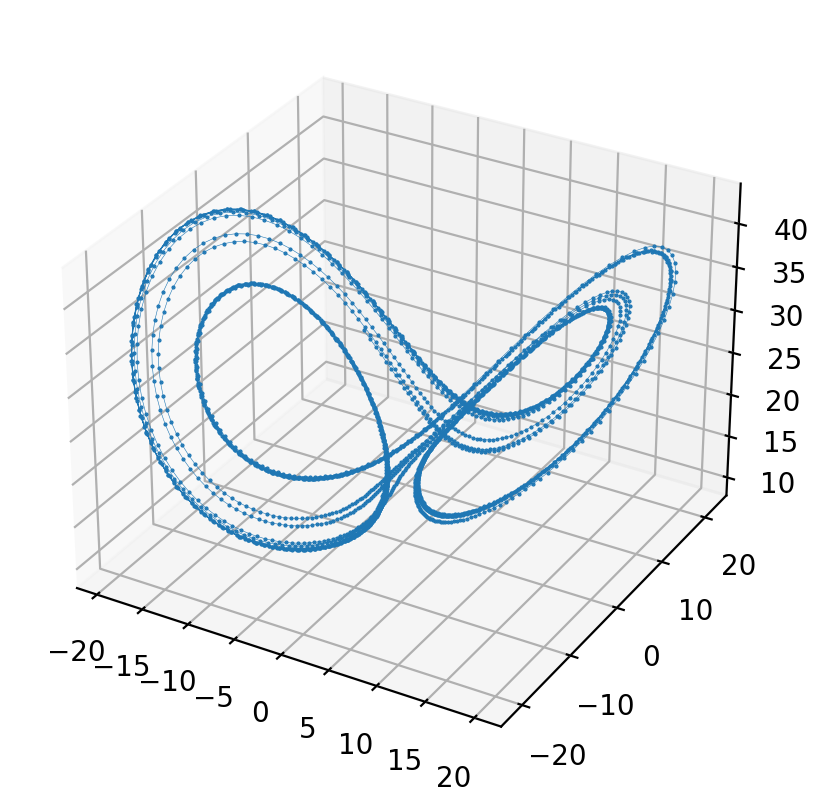

dx1 = -5.1997 * x1 + 8.09739 * x2
dx2 = 22.7796 * x1 + 0.369789 * x2 + -0.869172 * x1 x3
dx3 = -1.5847 * 1 + -2.46597 * x3 + 0.948571 * x1 x2



In [ ]:
for coef in coefs[1]:
    s.coef_ = coef
    eq = Equation(s.feature_library, coef)
    d, _ = gen_data(eq, (0, 20), 150, odes.lorenz_attractor.u0)
    plot_data(d, t, figsize=(5, 5))
    print(s.print_equation(fmt='g'))